In [1]:
import torch

if torch.cuda.is_available():    
    device = torch.device("cuda")
    print('There are %d GPU(s) available.' % torch.cuda.device_count())
    print('We will use the GPU:', torch.cuda.get_device_name(0))

else:
    print('No GPU available, using the CPU instead.')
    device = torch.device("cpu")

There are 1 GPU(s) available.
We will use the GPU: Tesla P100-PCIE-16GB


In [2]:
from google.colab import drive

In [4]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
# /content/drive/MyDrive/Colab Notebooks/Yolo

In [6]:
%pwd

'/content'

In [7]:
%ls

drive/  sample_data/


In [8]:
%cd drive/MyDrive/Colab Notebooks/Yolo

/content/drive/MyDrive/Colab Notebooks/Yolo


In [9]:
%cd yolov5

/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5


#데이터셋 다운 및 구성

In [ ]:
%mkdir '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat'


In [ ]:
%cd '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat'

/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat


In [ ]:
!curl -L "https://public.roboflow.com/ds/7IjBwptVd5?key=nLGEYhCPy1" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
 extracting: train/labels/000605_jpg.rf.0c32e7a0bc3cb35efb487e563bd531d2.txt  
 extracting: train/labels/000343_jpg.rf.0c2f20c5673eb0132c8f6d63906c5f2d.txt  
 extracting: train/labels/004238_jpg.rf.0c3465deac398afe856c752cc9d98852.txt  
 extracting: train/labels/004029_jpg.rf.0c5c615d8dc20133e108e813eca4234a.txt  
 extracting: train/labels/002532_jpg.rf.0cc8d54d2b360fa57e5402d53edae103.txt  
 extracting: train/labels/001680_jpg.rf.0c5c6aceea85a79a7a2404a54a6edc68.txt  
 extracting: train/labels/000015_jpg.rf.0c0cedbd11befb87888bc8887dca5a52.txt  
 extracting: train/labels/004978_jpg.rf.0cd5eb9b3507044f9cdcc2f2abee4f0b.txt  
 extracting: train/labels/002500_jpg.rf.0c525ff7b9202f6ed81fbcc8a1ce7831.txt  
 extracting: train/labels/003833_jpg.rf.0c6929cb9362e0f95beed22139bcb644.txt  
 extracting: train/labels/002127_jpg.rf.0a642389755589a074e3a2e35c8f4d0f.txt  
 extracting: train/labels/005215_jpg.rf.0c3bc4a4b40f03461eb7ae77a252210a.txt  
 extracting: tra

In [10]:
# /content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat

In [11]:
from glob import glob

train_img_list = glob('/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/train/images/*.jpg')
test_img_list = glob('/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/images/*.jpg')
print(len(train_img_list), len(test_img_list))

5269 1766


In [12]:
from sklearn.model_selection import train_test_split
import yaml

test_img_list, val_img_list = train_test_split(test_img_list, test_size=0.5, random_state=777)
print(len(train_img_list), len(test_img_list))

5269 883


In [ ]:
import yaml

# 각각 이미지 리스트 텍스트 파일에 넣어주기
with open('train.txt', 'w') as f:
    f.write('\n'.join(train_img_list) + '\n')

with open('test.txt', 'w') as f:
    f.write('\n'.join(test_img_list) + '\n')

with open('val.txt', 'w') as f:
    f.write('\n'.join(val_img_list) + '\n')

In [13]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [14]:
%cat data.yaml


train: '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/train/images'
test: '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/images'
val: '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/images'

nc: 3
names: ['head', 'helmet', 'person']

In [ ]:
%%writetemplate data.yaml

train: '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/train/images'
test: '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/images'
val: '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/images'

nc: 3
names: ['head', 'helmet', 'person']

In [ ]:
%cat data.yaml


train: '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/train/images'
test: '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/images'
val: '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/images'

nc: 3
names: ['head', 'helmet', 'person']

## YOLOv5 모델 (PyTorch)

* https://github.com/ultralytics/yolov5
* https://www.ultralytics.com

In [ ]:
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 9884, done.
remote: Counting objects: 100% (83/83), done.
remote: Compressing objects: 100% (72/72), done.
remote: Total 9884 (delta 43), reused 30 (delta 11), pack-reused 9801
Receiving objects: 100% (9884/9884), 10.36 MiB | 8.29 MiB/s, done.
Resolving deltas: 100% (6830/6830), done.


In [ ]:
# !rm -rf yolov5
%cd yolov5

/content/drive/My Drive/Colab Notebooks/Yolo/yolov5


In [16]:
%pip install -qr requirements.txt

     |████████████████████████████████| 596 kB 8.0 MB/s 


In [15]:
import torch
from IPython.display import Image, clear_output

#모델 구성

In [17]:
with open('data.yaml', 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [18]:
%cat '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/models/yolov5m.yaml'

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [19]:
%%writetemplate /content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/models/custom_yolov5m.yaml

# Parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [20]:
%cat '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/models/custom_yolov5m.yaml'


# Parameters
nc: 3  # number of classes
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, Fa

### 학습(Training)

* `img`: 입력 이미지 크기 정의
* `batch`: 배치 크기 결정
* `epochs`: 학습 기간 개수 정의
* `data`: yaml 파일 경로
* `cfg`: 모델 구성 지정
* `weights`: 가중치에 대한 경로 지정
* `name`: 결과 이름
* `nosave`: 최종 체크포인트만 저장
* `cache`: 빠른 학습을 위한 이미지 캐시

In [21]:
%time

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 6.2 µs


In [22]:
%cd '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5'

/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5


In [ ]:
!python train.py --img 416 --batch 64 --epochs 50 --data ./hardhat/data.yaml --cfg ./models/custom_yolov5x.yaml --weights '' --name hardhat_results --cache

train: weights=, cfg=./models/custom_yolov5s.yaml, data=./hardhat/data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=50, batch_size=64, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=hardhat_results, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, de

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir runs # 텐서보드로 로그 확인 map등 그래프

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
from keras.preprocessing import image
import matplotlib.pyplot as plt
from IPython.display import Image, display

In [ ]:
 !ls runs/train/hardhat_results

confusion_matrix.png				   results.png
events.out.tfevents.1636681123.c9e5aa33a72c.934.0  train_batch0.jpg
F1_curve.png					   train_batch1.jpg
hyp.yaml					   train_batch2.jpg
labels_correlogram.jpg				   val_batch0_labels.jpg
labels.jpg					   val_batch0_pred.jpg
opt.yaml					   val_batch1_labels.jpg
P_curve.png					   val_batch1_pred.jpg
PR_curve.png					   val_batch2_labels.jpg
R_curve.png					   val_batch2_pred.jpg
results.csv					   weights


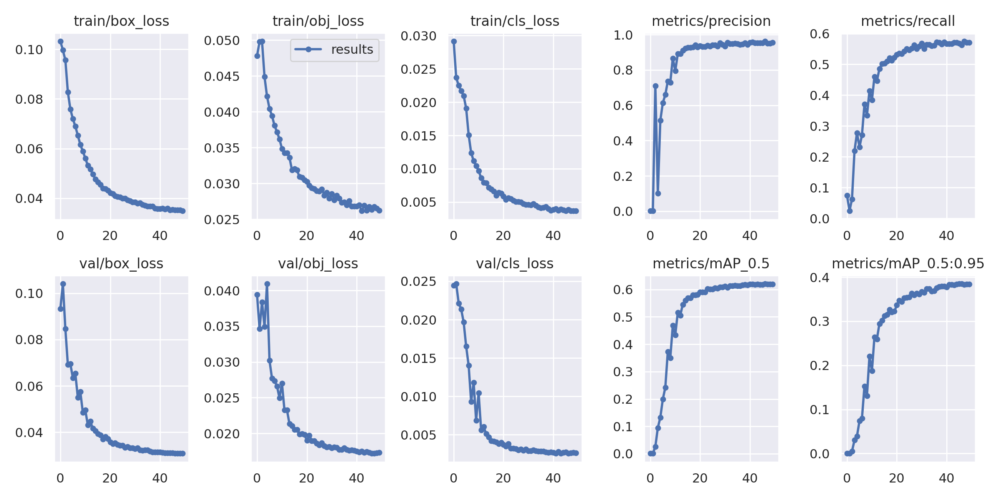

In [ ]:
Image(filename='runs/train/hardhat_results/results.png', width=1000)

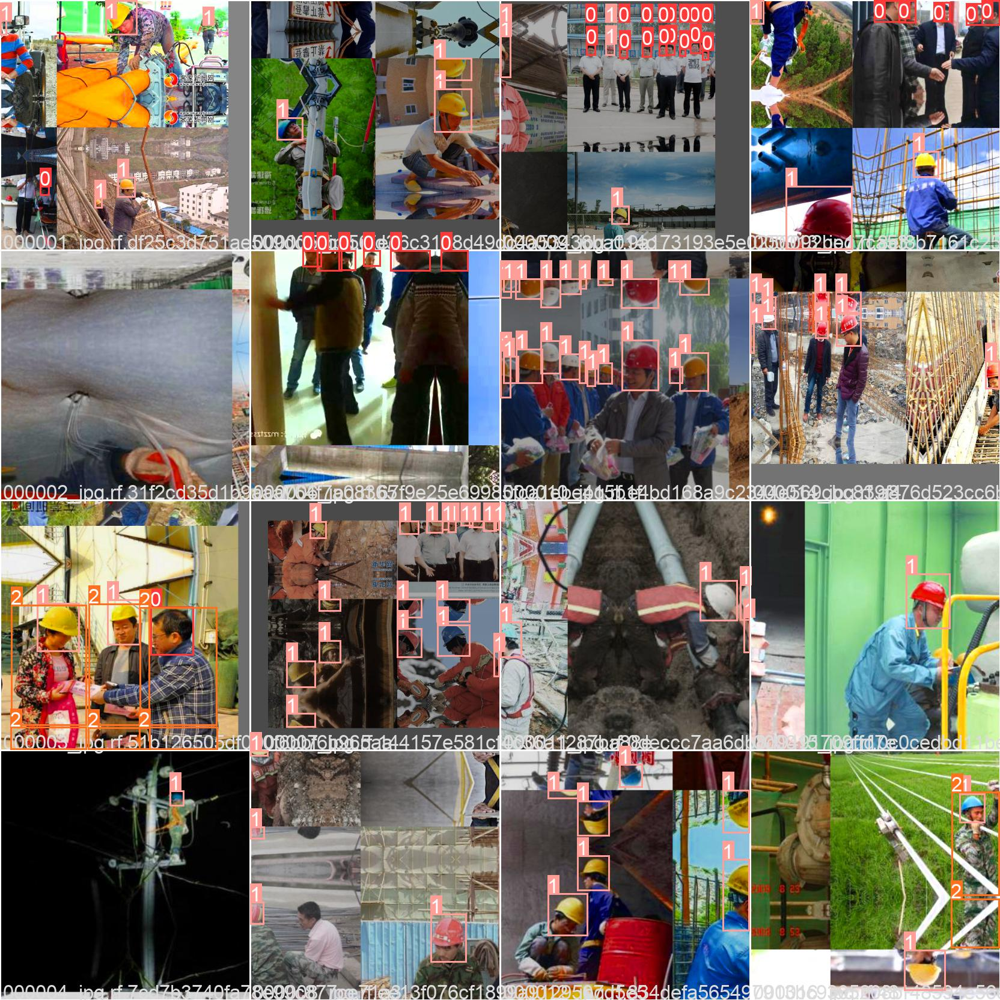

In [ ]:
Image(filename='runs/train/hardhat_results/train_batch0.jpg', width=1000)

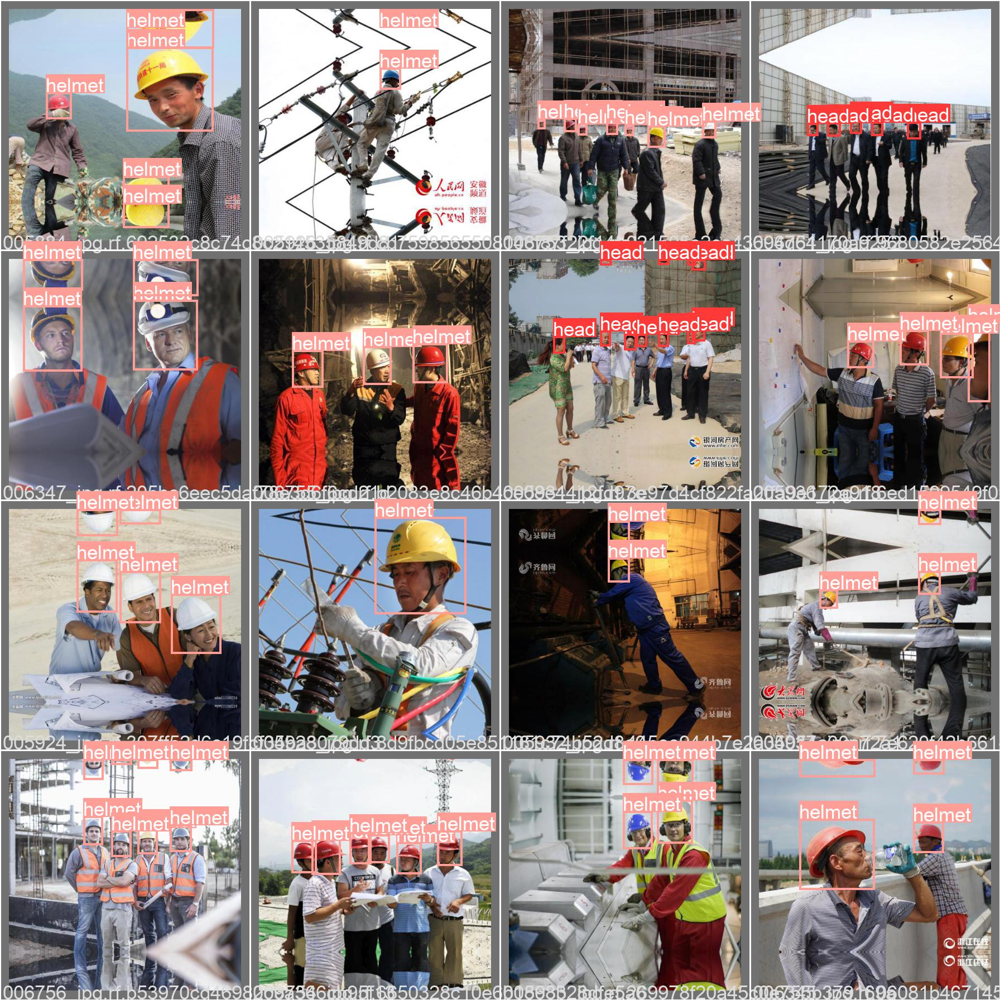

In [ ]:
Image(filename='runs/train/hardhat_results/val_batch0_labels.jpg', width=1000)

In [ ]:
!python val.py --weights runs/train/hardhat_results/weights/best.pt --data ./hardhat/data.yaml --img 416 --iou 0.65 --half

val: data=./hardhat/data.yaml, weights=['runs/train/hardhat_results/weights/best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.65, task=val, device=, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/labels.cache' images and labels... 1766 found, 0 missing, 0 empty, 0 corrupted: 100% 1766/1766 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 56/56 [00:19<00:00,  2.89it/s]
                 all       1766       8915      0.961      0.563      0.619      0.384
                head       1766       2208      0.928      0.837      0.908     

In [ ]:
!python val.py --weights runs/train/hardhat_results/weights/best.pt --data ./hardhat/data.yaml --img 416 --task test #test 파일에 대해 validation

val: data=./hardhat/data.yaml, weights=['runs/train/hardhat_results/weights/best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.6, task=test, device=, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/labels.cache' images and labels... 1766 found, 0 missing, 0 empty, 0 corrupted: 100% 1766/1766 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 56/56 [00:19<00:00,  2.85it/s]
                 all       1766       8915      0.962      0.563      0.621      0.385
                head       1766       2208       0.93      0.836      0.911   

In [ ]:
%ls runs/train/hardhat_results/weights

best.pt  last.pt


In [ ]:
!python detect.py --weights runs/train/hardhat_results/weights/best.pt --img 416 --conf 0.4 --source ./hardhat/test2/images

detect: weights=['runs/train/hardhat_results/weights/best.pt'], source=./hardhat/test2/images, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/1000 /content/drive/My Drive/Colab Notebooks/Yolo/yolov5/hardhat/test2/images/hard_hat_workers1.png: 416x416 9 helmets, Done. (0.007s)
image 2/1000 /content/drive/My Drive/Colab Notebooks/Yolo/yolov5/hardhat/test2/images/hard_hat_workers1009.png: 416x416 4 helmets, Done. (0.009s)
image 3/1000 /content/drive/My Drive/Colab Notebooks/Yolo/yolov5/hardhat/test2/images/hard

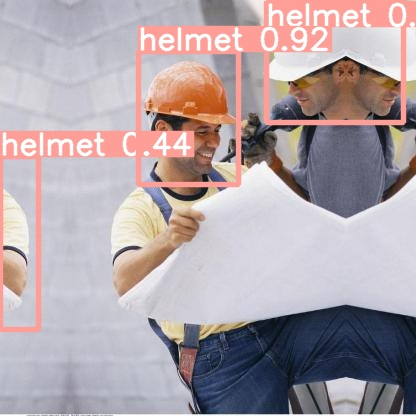

In [ ]:
import glob # 확인
import random

image_name = random.choice(glob.glob('runs/detect/exp/*jpg'))
display(Image(filename=image_name))

In [ ]:
# /content/drive/MyDrive/hardhat
%mkdir '/content/drive/MyDrive/hardhat/epoch_50'

In [ ]:
# %mkdir /content/drive/My\ Drive/hardhat
%cp 'runs/train/hardhat_results/weights/best.pt' '/content/drive/MyDrive/hardhat/epoch_50/'

In [ ]:
%time

CPU times: user 2 µs, sys: 1e+03 ns, total: 3 µs
Wall time: 5.01 µs


In [ ]:
%cd '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5'

/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5


In [ ]:
!python train.py --img 416 --batch 64 --epochs 100 --data ./hardhat/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name hardhat_results --cache

train: weights=, cfg=./models/custom_yolov5s.yaml, data=./hardhat/data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=100, batch_size=64, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=hardhat_results, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, d

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir runs # 텐서보드로 로그 확인 map등 그래프

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
 !ls runs/train/hardhat_results2

confusion_matrix.png				    results.png
events.out.tfevents.1636687923.c9e5aa33a72c.2407.0  train_batch0.jpg
F1_curve.png					    train_batch1.jpg
hyp.yaml					    train_batch2.jpg
labels_correlogram.jpg				    val_batch0_labels.jpg
labels.jpg					    val_batch0_pred.jpg
opt.yaml					    val_batch1_labels.jpg
P_curve.png					    val_batch1_pred.jpg
PR_curve.png					    val_batch2_labels.jpg
R_curve.png					    val_batch2_pred.jpg
results.csv					    weights


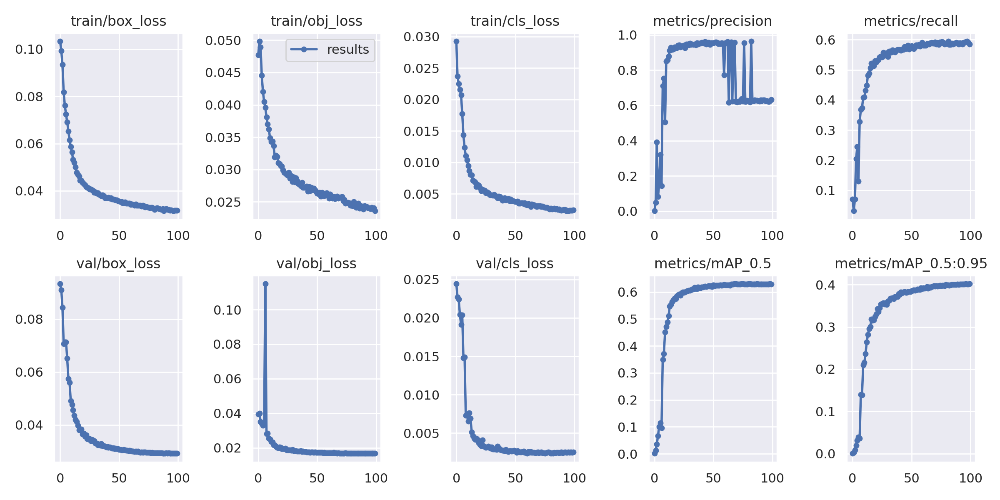

In [ ]:
Image(filename='runs/train/hardhat_results2/results.png', width=1000)

In [ ]:
!python val.py --weights runs/train/hardhat_results2/weights/best.pt --data ./hardhat/data.yaml --img 416 --iou 0.65 --half

val: data=./hardhat/data.yaml, weights=['runs/train/hardhat_results2/weights/best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.65, task=val, device=, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/labels.cache' images and labels... 1766 found, 0 missing, 0 empty, 0 corrupted: 100% 1766/1766 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 56/56 [00:19<00:00,  2.91it/s]
                 all       1766       8915      0.631      0.585      0.628      0.401
                head       1766       2208      0.933      0.872      0.925    

In [ ]:
!python val.py --weights runs/train/hardhat_results2/weights/best.pt --data ./hardhat/data.yaml --img 416 --task test #test 파일에 대해 validation

val: data=./hardhat/data.yaml, weights=['runs/train/hardhat_results2/weights/best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.6, task=test, device=, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/labels.cache' images and labels... 1766 found, 0 missing, 0 empty, 0 corrupted: 100% 1766/1766 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 56/56 [00:18<00:00,  2.96it/s]
                 all       1766       8915      0.632      0.585      0.629      0.403
                head       1766       2208      0.937      0.872      0.927  

In [ ]:
%ls runs/train/hardhat_results2/weights

best.pt  last.pt


In [ ]:
!python detect.py --weights runs/train/hardhat_results/weights/best.pt --img 416 --conf 0.4 --source ./hardhat/test/images

detect: weights=['runs/train/hardhat_results2/weights/best.pt'], source=./hardhat/test/images, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/1766 /content/drive/My Drive/Colab Notebooks/Yolo/yolov5/hardhat/test/images/005298_jpg.rf.7d1070e4a462d4c636a68e64f2013761.jpg: 416x416 7 helmets, Done. (0.012s)
image 2/1766 /content/drive/My Drive/Colab Notebooks/Yolo/yolov5/hardhat/test/images/005299_jpg.rf.a79cacc62cdd99ad871cf1786ad865ff.jpg: 416x416 2 helmets, Done. (0.011s)
image 3/1766 /content/drive/My Drive/

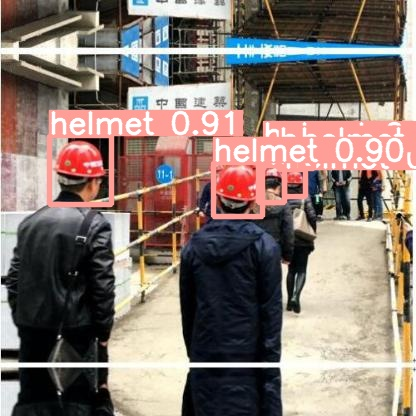

In [ ]:
import glob # 확인
import random

image_name = random.choice(glob.glob('runs/detect/exp2/*jpg'))
display(Image(filename=image_name))

In [ ]:
# /content/drive/MyDrive/hardhat
%mkdir '/content/drive/MyDrive/hardhat/epoch_100'

In [ ]:
# %mkdir /content/drive/My\ Drive/hardhat
%cp 'runs/train/hardhat_results2/weights/best.pt' '/content/drive/MyDrive/hardhat/epoch_100/'

In [ ]:
!python train.py --img 416 --batch 64 --epochs 50 --data ./hardhat/data.yaml --cfg ./models/custom_yolov5x.yaml --weights '' --name hardhat_results3 --cache

train: weights=, cfg=./models/custom_yolov5x.yaml, data=./hardhat/data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=50, batch_size=64, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=hardhat_results3, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.

In [ ]:
!python detect.py --weights runs/train/hardhat_results/weights/best.pt --img 416 --conf 0.4 --source ./hardhat/test2/images

detect: weights=['runs/train/hardhat_results/weights/best.pt'], source=./hardhat/test2/images, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13

requirements: 1 package updated per /content/drive/My Drive/Colab Notebooks/Yolo/yolov5/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 213 layers, 

In [ ]:
import os

In [ ]:
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"

In [ ]:
os.environ["CUDA_VISIBLE_DEVICES"]= "2,3"

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
torch.cuda.is_available()

False

In [ ]:
print('Device:', device)

Device: cpu


In [ ]:
!python detect.py --weights runs/train/hardhat_results/weights/best.pt --img 416 --conf 0.4 --source ./hardhat/test3/images

detect: weights=['runs/train/hardhat_results/weights/best.pt'], source=./hardhat/test3/images, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CPU

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/66 /content/drive/My Drive/Colab Notebooks/Yolo/yolov5/hardhat/test3/images/hel1.jpg: 288x416 2 helmets, Done. (0.076s)
image 2/66 /content/drive/My Drive/Colab Notebooks/Yolo/yolov5/hardhat/test3/images/hel10.jpg: 320x416 1 helmet, Done. (0.081s)
image 3/66 /content/drive/My Drive/Colab Notebooks/Yolo/yolov5/hardhat/test3/images/hel100.jpg: 288x416 1 head, Done. (0.062s)
image 4/66 /content/drive/My Dri

In [23]:
!python train.py --img 416 --batch 64 --epochs 50 --data ./hardhat/data.yaml --cfg ./models/custom_yolov5m.yaml --weights '' --name hardhat_results --cache

train: weights=, cfg=./models/custom_yolov5m.yaml, data=./hardhat/data.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=50, batch_size=64, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=hardhat_results, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.0

In [24]:
%load_ext tensorboard

In [25]:
%tensorboard --logdir runs # 텐서보드로 로그 확인 map등 그래프

Output hidden; open in https://colab.research.google.com to view.

In [26]:
!python val.py --weights runs/train/hardhat_results37/weights/best.pt --data ./hardhat/data.yaml --img 416 --iou 0.6 --half

val: data=./hardhat/data.yaml, weights=['runs/train/hardhat_results37/weights/best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.6, task=val, device=, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 290 layers, 20861016 parameters, 0 gradients, 48.0 GFLOPs
val: Scanning '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/labels.cache' images and labels... 1766 found, 0 missing, 0 empty, 0 corrupted: 100% 1766/1766 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 56/56 [00:17<00:00,  3.13it/s]
                 all       1766       8915      0.948      0.588      0.631      0.399
                head       1766       2208      0.904      0.877      0.928   

In [27]:
!python val.py --weights runs/train/hardhat_results37/weights/best.pt --data ./hardhat/data.yaml --img 416 --task test #test 파일에 대해 validation

val: data=./hardhat/data.yaml, weights=['runs/train/hardhat_results37/weights/best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.6, task=test, device=, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 290 layers, 20861016 parameters, 0 gradients, 48.0 GFLOPs
test: Scanning '/content/drive/MyDrive/Colab Notebooks/Yolo/yolov5/hardhat/test/labels.cache' images and labels... 1766 found, 0 missing, 0 empty, 0 corrupted: 100% 1766/1766 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 56/56 [00:18<00:00,  3.07it/s]
                 all       1766       8915      0.947      0.589      0.632      0.399
                head       1766       2208      0.903      0.879      0.929

In [28]:
!python detect.py --weights runs/train/hardhat_results37/weights/best.pt --img 416 --conf 0.4 --source ./hardhat/test/images

detect: weights=['runs/train/hardhat_results37/weights/best.pt'], source=./hardhat/test/images, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 2021-11-12 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 290 layers, 20861016 parameters, 0 gradients, 48.0 GFLOPs
image 1/1766 /content/drive/My Drive/Colab Notebooks/Yolo/yolov5/hardhat/test/images/005298_jpg.rf.7d1070e4a462d4c636a68e64f2013761.jpg: 416x416 5 helmets, Done. (0.009s)
image 2/1766 /content/drive/My Drive/Colab Notebooks/Yolo/yolov5/hardhat/test/images/005299_jpg.rf.a79cacc62cdd99ad871cf1786ad865ff.jpg: 416x416 1 helmet, Done. (0.009s)
image 3/1766 /content/drive/My Drive